In [1]:
import pandas as pd
import folium

# Load the dataset
file_path = 'london_airbnb_data.csv'  # Replace with your dataset's path
data = pd.read_csv(file_path)

# Create a map centered around London
london_map = folium.Map(location=[51.5074, -0.1278], zoom_start=11)

# Add points for each listing
for idx, row in data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=1,  # Small radius for individual listings
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(london_map)

# Display the map
london_map


In [2]:
import pandas as pd
import folium
from folium.plugins import HeatMap

# Load the dataset
file_path = 'london_airbnb_data.csv'  # Make sure to replace this with the actual path to your dataset
data = pd.read_csv(file_path)

# Create a map centered around London
london_heatmap = folium.Map(location=[51.5074, -0.1278], zoom_start=11)

# Extract the latitude and longitude as a list of lists
heat_data = [[row['lat'], row['lng']] for index, row in data.iterrows()]

# Add a heatmap layer to the map
HeatMap(heat_data).add_to(london_heatmap)

# Display the map
london_heatmap


In [3]:
import pandas as pd
import folium
from folium.plugins import HeatMap

# Load the dataset
file_path = 'london_airbnb_data.csv'  # Make sure to replace this with the actual path to your dataset
data = pd.read_csv(file_path)

# Simulate price tiers by dividing the dataset into quartiles based on price
# Note: Adjust the column name if your dataset has a direct 'price' column
data['price_tier'] = pd.qcut(data['realSum'], 4, labels=False)

# Generate heat data with intensity based on price tier
heat_data_price = []
for index, row in data.iterrows():
    # Repeat the location based on its price tier to simulate intensity
    for _ in range(int(row['price_tier']) + 1):  # Adding 1 to ensure even the lowest tier is represented
        heat_data_price.append([row['lat'], row['lng']])

# Create a new map centered around London
london_price_heatmap = folium.Map(location=[51.5074, -0.1278], zoom_start=11)

# Add a heatmap layer to the map to visualize the price tiers
HeatMap(heat_data_price).add_to(london_price_heatmap)

# Display the map
london_price_heatmap


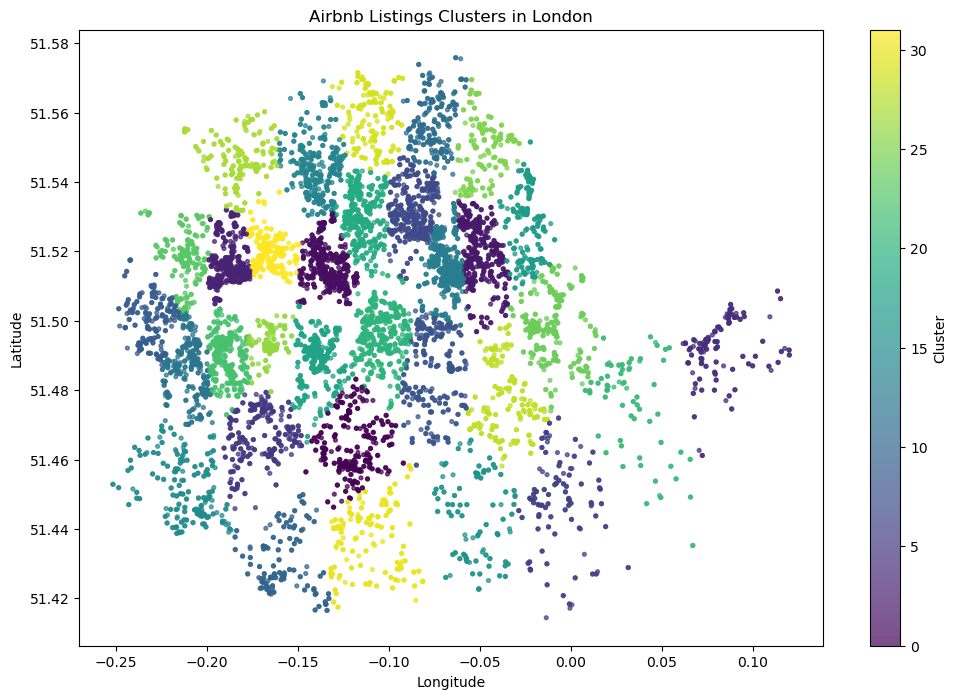

Listings per Cluster:
 cluster
0     334
1     517
2     529
3     501
4     174
5     287
6     165
7     466
8     318
9     226
10    219
11    246
12    360
13    665
14    380
15    262
16    154
17    255
18    381
19    468
20    434
21    121
22    448
23    238
24    342
25    185
26    189
27    210
28    212
29    187
30    206
31    314
Name: count, dtype: int64

Average Price per Cluster:
 cluster
0     275.887933
1     699.681740
2     255.716659
3     439.448486
4     222.096788
5     310.810015
6     184.837153
7     394.528495
8     272.671293
9     258.388389
10    230.829924
11    259.163909
12    315.858139
13    350.590369
14    409.730758
15    229.781423
16    189.744050
17    233.556486
18    563.420806
19    373.616280
20    337.856006
21    169.903625
22    545.373833
23    395.330926
24    346.724251
25    245.666961
26    549.839468
27    306.380677
28    320.350680
29    314.658951
30    196.975333
31    525.347005
Name: realSum, dtype: float64

Average Cle

In [4]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load your dataset
file_path = 'london_airbnb_data.csv'  # Update this to the path of your dataset
data = pd.read_csv(file_path)

# Extracting the geographical coordinates
coordinates = data[['lat', 'lng']]

# Clustering the listings into 25 clusters
kmeans = KMeans(n_clusters=32, init='k-means++', max_iter=300, n_init=10, random_state=42)
data['cluster'] = kmeans.fit_predict(coordinates)

# Visualizing the clusters on a map
plt.figure(figsize=(12, 8))
plt.scatter(data['lng'], data['lat'], c=data['cluster'], cmap='viridis', marker='.', s=30, alpha=0.7)
plt.title('Airbnb Listings Clusters in London')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Cluster')
plt.show()

# Summarizing the clusters
# Count listings in each cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# Calculate average price per cluster
average_prices = data.groupby('cluster')['realSum'].mean().sort_index()  # Replace 'realSum' if your column name is different

# Example: Calculate average cleanliness rating per cluster
# Ensure your dataset has a 'cleanliness_rating' column or adjust as necessary
average_cleanliness = data.groupby('cluster')['cleanliness_rating'].mean().sort_index()

print("Listings per Cluster:\n", cluster_counts)
print("\nAverage Price per Cluster:\n", average_prices)
print("\nAverage Cleanliness Rating per Cluster:\n", average_cleanliness)


In [5]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

# Load your Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Convert the Airbnb data to a GeoDataFrame using WGS 84 CRS (latitude and longitude)
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Transform the CRS to British National Grid (EPSG:27700) to match the London wards/boroughs shapefile
gdf_airbnb = gdf_airbnb.to_crs('EPSG:27700')

# Load the London wards/boroughs boundaries shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_wards = gpd.read_file(path_to_shapefile)

# Ensure that the London wards/boroughs GeoDataFrame is using the British National Grid CRS
# This step may be redundant if the shapefile is already in EPSG:27700, but it's good practice to confirm
london_wards = london_wards.to_crs('EPSG:27700')

# Perform a spatial join to assign each Airbnb listing to a ward/borough
airbnb_with_wards = gpd.sjoin(gdf_airbnb, london_wards, how="inner", predicate='intersects')

# airbnb_with_wards now includes ward/borough information for each listing
# Adjust column names as necessary based on your specific shapefile's attributes

# Print the first few rows to verify
print(airbnb_with_wards.head())


    Unnamed: 0     realSum        room_type  room_shared  room_private  \
0            0  570.098074  Entire home/apt        False         False   
7            7  155.695101     Private room        False          True   
18          18  207.436675     Private room        False          True   
32          32  265.528352     Private room        False          True   
62          62  262.941273  Entire home/apt        False         False   

    person_capacity  host_is_superhost  multi  biz  cleanliness_rating  ...  \
0               2.0              False      0    0                10.0  ...   
7               2.0              False      1    0                10.0  ...   
18              2.0               True      1    0                10.0  ...   
32              2.0              False      1    0                10.0  ...   
62              4.0              False      0    0                 9.0  ...   

         lat  day_type                       geometry  index_right  \
0   51.465

/Users/vishal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


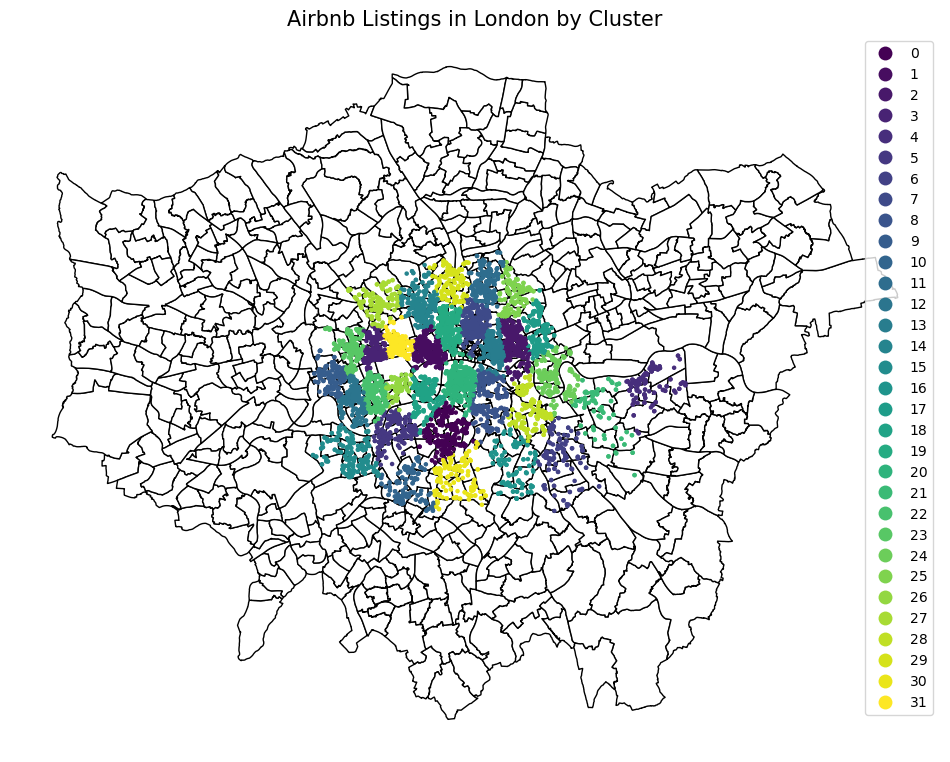

In [6]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from shapely.geometry import Point

# Load Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Assuming 'lat' and 'lng' are the latitude and longitude columns
# Perform k-means clustering with k=32
kmeans = KMeans(n_clusters=32, random_state=42)
data['cluster_label'] = kmeans.fit_predict(data[['lat', 'lng']])

# Convert Airbnb data to a GeoDataFrame using WGS 84 CRS
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Transform CRS to British National Grid (EPSG:27700) for spatial join
gdf_airbnb = gdf_airbnb.to_crs('EPSG:27700')

# Load the London boroughs or wards shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_wards = gpd.read_file(path_to_shapefile).to_crs('EPSG:27700')

# Spatial join to associate listings with wards
airbnb_with_wards = gpd.sjoin(gdf_airbnb, london_wards, how="inner", predicate='intersects')

# Plotting
fig, ax = plt.subplots(figsize=(12, 12))
london_wards.plot(ax=ax, color='white', edgecolor='black')
airbnb_with_wards.plot(ax=ax, column='cluster_label', cmap='viridis', markersize=5, legend=True, categorical=True)

ax.set_title('Airbnb Listings in London by Cluster', fontsize=15)
ax.set_axis_off()

plt.show()


In [7]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import KMeans
from shapely.geometry import Point

# Load Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Perform k-means clustering with k=32 on the original lat, lng data
kmeans = KMeans(n_clusters=32, random_state=42)
clusters = kmeans.fit_predict(data[['lat', 'lng']])
data['cluster_label'] = clusters

# Convert the Airbnb data to a GeoDataFrame using WGS 84 CRS
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Load the London boroughs or wards shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_wards = gpd.read_file(path_to_shapefile).to_crs('EPSG:4326')  # Assuming the shapefile is in WGS 84

# Spatial join to associate listings with wards/boroughs
# Ensure the CRS matches; if the wards shapefile is not in WGS 84, transform it before joining
airbnb_with_wards = gpd.sjoin(gdf_airbnb, london_wards, how="inner", predicate='intersects')

# Assuming 'NAME' column in london_wards GeoDataFrame contains the borough names
airbnb_with_wards['borough_name'] = airbnb_with_wards['NAME']

# Create a base map
m = folium.Map(location=[data['lat'].mean(), data['lng'].mean()], zoom_start=10, tiles='CartoDB positron')

# Use MarkerCluster to cluster the points
marker_cluster = MarkerCluster().add_to(m)

# Iterate through the DataFrame and add each listing to the map
for idx, row in airbnb_with_wards.iterrows():
    location = [row['lat'], row['lng']]
    tooltip = f"Cluster: {row['cluster_label']}, Borough: {row['borough_name']}"
    folium.Marker(location, tooltip=tooltip).add_to(marker_cluster)

# Display the map
m

# Save the map as an HTML file
m.save('london_airbnb_clusters.html')

# Analyze the most common borough for each cluster
cluster_borough_counts = airbnb_with_wards.groupby(['cluster_label', 'borough_name']).size().reset_index(name='counts')
most_common_boroughs = cluster_borough_counts.loc[cluster_borough_counts.groupby(['cluster_label'])['counts'].idxmax()]

print(most_common_boroughs)


/Users/vishal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


     cluster_label                     borough_name  counts
0                0                     Brixton Hill      64
19               1                         West End     175
20               2                    Bethnal Green     107
38               3                   Lancaster Gate     180
48               4              Thamesmead Moorings      43
60               5                  St. Mary's Park      88
68               6                 Lewisham Central      51
84               7         Hoxton East & Shoreditch     132
95               8  London Bridge & West Bermondsey      69
109              9             Hammersmith Broadway      62
117             10                         Graveney      87
136             11                  Stoke Newington      42
139             12         Avonmore and Brook Green      70
165             13                      Whitechapel     280
168             14   Camden Town with Primrose Hill      84
186             15                      

In [8]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import KMeans
from shapely.geometry import Point

# Assuming necessary data loading and preparation steps have been completed

# Load Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Perform k-means clustering with k=32 on the original lat, lng data
kmeans = KMeans(n_clusters=32, random_state=42)
clusters = kmeans.fit_predict(data[['lat', 'lng']])
data['cluster_label'] = clusters

# Convert the Airbnb data to a GeoDataFrame using WGS 84 CRS
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Load the London boroughs or wards shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_wards = gpd.read_file(path_to_shapefile).to_crs('EPSG:4326')  # Assuming the shapefile is in WGS 84

# Spatial join to associate listings with wards/boroughs
airbnb_with_wards = gpd.sjoin(gdf_airbnb, london_wards, how="inner", predicate='intersects')

# Extract the borough name (adjust 'NAME' if your column is different)
airbnb_with_wards['borough_name'] = airbnb_with_wards['NAME']

# Create a base map centered around the mean latitude and longitude
m = folium.Map(location=[data['lat'].mean(), data['lng'].mean()], zoom_start=10, tiles='CartoDB positron')

# Use MarkerCluster to cluster the points
marker_cluster = MarkerCluster().add_to(m)

# Add each Airbnb listing to the map with cluster and borough information in the tooltip
for idx, row in airbnb_with_wards.iterrows():
    location = [row['lat'], row['lng']]
    tooltip = f"Cluster: {row['cluster_label']}, Borough: {row['borough_name']}"
    folium.Marker(location, tooltip=tooltip).add_to(marker_cluster)

# Display the map directly in the Jupyter Notebook
m


/Users/vishal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [9]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import KMeans
from shapely.geometry import Point

# Load Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Perform k-means clustering with k=32 on the original lat, lng data
kmeans = KMeans(n_clusters=32, random_state=42)
clusters = kmeans.fit_predict(data[['lat', 'lng']])
data['cluster_label'] = clusters

# Convert the Airbnb data to a GeoDataFrame using WGS 84 CRS
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Load the London boroughs shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_boroughs = gpd.read_file(path_to_shapefile).to_crs('EPSG:4326')  # Assuming the shapefile is in WGS 84

# Spatial join to associate listings with boroughs
airbnb_with_boroughs = gpd.sjoin(gdf_airbnb, london_boroughs, how="inner", predicate='intersects')

# Use the 'DISTRICT' column for borough names
airbnb_with_boroughs['borough_name'] = airbnb_with_boroughs['DISTRICT']

# Create a base map
m = folium.Map(location=[data['lat'].mean(), data['lng'].mean()], zoom_start=10, tiles='CartoDB positron')

# Use MarkerCluster to cluster the points
marker_cluster = MarkerCluster().add_to(m)

# Iterate through the DataFrame and add each listing to the map
for idx, row in airbnb_with_boroughs.iterrows():
    location = [row['lat'], row['lng']]
    tooltip = f"Cluster: {row['cluster_label']}, Borough: {row['borough_name']}"
    folium.Marker(location, tooltip=tooltip).add_to(marker_cluster)

# Display the map in Jupyter Notebook
m

# Analyze the most common borough for each cluster
cluster_borough_counts = airbnb_with_boroughs.groupby(['cluster_label', 'borough_name']).size().reset_index(name='counts')
most_common_boroughs = cluster_borough_counts.loc[cluster_borough_counts.groupby(['cluster_label'])['counts'].idxmax()]

print(most_common_boroughs)


/Users/vishal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


    cluster_label            borough_name  counts
0               0                 Lambeth     332
3               1     City of Westminster     330
5               2           Tower Hamlets     489
6               3     City of Westminster     437
8               4               Greenwich     174
12              5              Wandsworth     248
14              6                Lewisham     161
16              7                 Hackney     301
19              8               Southwark     318
20              9  Hammersmith and Fulham     226
22             10              Wandsworth     194
23             11                 Hackney     221
25             12  Hammersmith and Fulham     316
31             13           Tower Hamlets     602
32             14                  Camden     343
35             15              Wandsworth     258
36             16                Lewisham      99
39             17           Tower Hamlets     245
40             18     City of Westminster     284


In [10]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from sklearn.cluster import KMeans
from shapely.geometry import Point

"""map for the boroughs"""

# Load Airbnb data
file_path = 'london_airbnb_data.csv'  # Update this path
data = pd.read_csv(file_path)

# Perform k-means clustering with k=32 on the original lat, lng data
kmeans = KMeans(n_clusters=32, random_state=42)
clusters = kmeans.fit_predict(data[['lat', 'lng']])
data['cluster_label'] = clusters

# Convert the Airbnb data to a GeoDataFrame using WGS 84 CRS
gdf_airbnb = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.lng, data.lat), crs='EPSG:4326')

# Load the London boroughs shapefile
path_to_shapefile = 'London-wards-2018_ESRI/London_Ward.shp'  # Update this path
london_boroughs = gpd.read_file(path_to_shapefile).to_crs('EPSG:4326')

# Spatial join to associate listings with boroughs
airbnb_with_boroughs = gpd.sjoin(gdf_airbnb, london_boroughs, how="inner", predicate='intersects')

# Use the 'DISTRICT' column for borough names
airbnb_with_boroughs['borough_name'] = airbnb_with_boroughs['DISTRICT']

# Create a base map
m = folium.Map(location=[data['lat'].mean(), data['lng'].mean()], zoom_start=10, tiles='CartoDB positron')

# Use MarkerCluster to cluster the points
marker_cluster = MarkerCluster().add_to(m)

# Iterate through the DataFrame and add each listing to the map
for idx, row in airbnb_with_boroughs.iterrows():
    location = [row['lat'], row['lng']]
    tooltip = f"Cluster: {row['cluster_label']}, Borough: {row['borough_name']}"
    folium.Marker(location, tooltip=tooltip).add_to(marker_cluster)

# Display the map in Jupyter Notebook
m


/Users/vishal/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
